In [1]:
# Midterm
# Andrew Logue

import matplotlib.pyplot as plt
import numpy as np 
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.utils import resample
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score, recall_score, roc_auc_score, precision_score
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics 
from sklearn.svm import SVC
from sklearn import metrics 
from sklearn.model_selection import validation_curve
import seaborn as sns
import statsmodels.api as sm
import scipy.stats as stats
from sklearn.preprocessing import LabelEncoder 
import copy
from IPython.display import Image
from sklearn.pipeline import make_pipeline
%matplotlib inline
sns.set() 

# EDA

In [2]:
# 1. Read in the data set and perform preliminary checks

df = pd.read_csv('creditcard_small.csv')
print(df)

classes = pd.unique(df['Class'])
num_classes = len(classes)
each_class = df['Class'].value_counts()

print(classes)
print(num_classes)
print(each_class)

             V1        V2        V3        V4        V5        V6        V7  \
0     -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1      1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2     -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3     -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4     -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   
...         ...       ...       ...       ...       ...       ...       ...   
99994 -0.228866  0.086431  0.791165 -1.451021  1.141154  0.070110  0.442420   
99995 -1.336121  1.671947  0.994155  0.420318 -0.440923 -0.008386 -0.893860   
99996  0.662465 -1.336560  0.791566  0.425701 -1.391976  0.145471 -0.476652   
99997 -4.930001 -1.090715  0.298037  1.890524 -1.058087 -0.329315 -1.498278   
99998  0.982019 -0.161026  0.534280  0.714558  0.108865  1.154723 -0.298831   

             V8        V9       V10  ...       V20 

In [3]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 29 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   V1      99999 non-null  float64
 1   V2      99999 non-null  float64
 2   V3      99999 non-null  float64
 3   V4      99999 non-null  float64
 4   V5      99999 non-null  float64
 5   V6      99999 non-null  float64
 6   V7      99999 non-null  float64
 7   V8      99999 non-null  float64
 8   V9      99999 non-null  float64
 9   V10     99999 non-null  float64
 10  V11     99999 non-null  float64
 11  V12     99999 non-null  float64
 12  V13     99999 non-null  float64
 13  V14     99999 non-null  float64
 14  V15     99999 non-null  float64
 15  V16     99999 non-null  float64
 16  V17     99999 non-null  float64
 17  V18     99999 non-null  float64
 18  V19     99999 non-null  float64
 19  V20     99999 non-null  float64
 20  V21     99999 non-null  float64
 21  V22     99999 non-null  float64
 22

In [4]:
# 2. Check missing values, outliers and statistics

df.isna().apply(pd.value_counts)

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
False,99999,99999,99999,99999,99999,99999,99999,99999,99999,99999,...,99999,99999,99999,99999,99999,99999,99999,99999,99999,99999


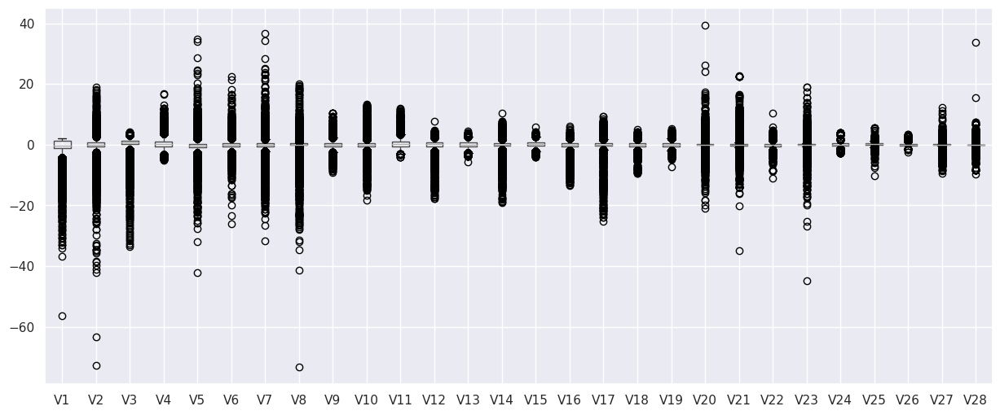

,count,mean,std,min,25%,50%,75%,max
V1,99999.0,-0.262096,1.859057,-56.407510,-1.028101,-0.260556,1.153327,1.960497
V2,99999.0,-0.032374,1.656854,-72.715728,-0.598711,0.078315,0.735736,18.902453
V3,99999.0,0.676251,1.322888,-33.680984,0.176781,0.753991,1.376333,4.226108
V4,99999.0,0.162603,1.349249,-5.172595,-0.711442,0.192567,1.032416,16.715537
V5,99999.0,-0.278507,1.356376,-42.147898,-0.898645,-0.314370,0.249733,34.801666
V6,99999.0,0.094066,1.301356,-26.160506,-0.647870,-0.157022,0.486356,22.529298
V7,99999.0,-0.108712,1.210925,-31.764946,-0.600209,-0.069107,0.414667,36.677268
V8,99999.0,0.056009,1.207528,-73.216718,-0.137457,0.074130,0.360506,20.007208
V9,99999.0,-0.046529,1.121255,-9.283925,-0.698812,-0.119105,0.558226,10.392889
V10,99999.0,-0.023187,1.070409,-18.271168,-0.496342,-0.094927,0.439029,13.249433


In [5]:
df.iloc[:,:28].boxplot(figsize = (15,6))

#plt.savefig('plots/i0.png')
plt.show()
df.iloc[:,:28].describe().T

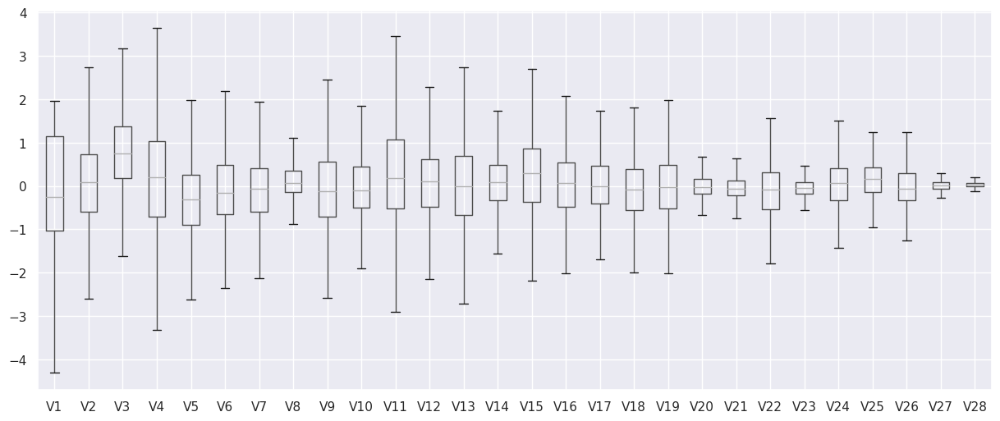

In [6]:
cols = df.iloc[:,:28]
for col in cols:
    q1 = df[col].quantile(0.25)
    q3 = df[col].quantile(0.75)
    iqr = q3 - q1
    df.loc[(df[col] < (q1 - 1.5 * iqr)), col] = (q1 - 1.5 * iqr)
    df.loc[(df[col] > (q3 + 1.5 * iqr)), col] = (q3 + 1.5 * iqr)
# make a new boxplot to check if removing them worked
df.iloc[:,:28].boxplot(figsize = (15,6))
plt.show()

In [7]:
# Create balanced dataset
# Separate the classes
class_0 = df[df['Class'] == 0]
class_1 = df[df['Class'] == 1]

# Resample the majority class (Class 0) to match the number of samples in Class 1
class_0_resampled = resample(class_0, replace=True, n_samples=len(class_1), random_state=42)

# Concatenate the resampled majority class with the original minority class
balanced_df = pd.concat([class_0_resampled, class_1])

# Shuffle the DataFrame to mix the classes
balanced_df = balanced_df.sample(frac=1, random_state=42).reset_index(drop=True)

print(balanced_df)
print(balanced_df['Class'].value_counts())

           V1        V2        V3        V4        V5        V6        V7  \
0   -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
1   -3.240187  2.737407 -1.622546  3.648203 -2.621212 -0.126271 -2.122524   
2   -0.696353  0.359000 -0.334748 -1.073729  1.972299  2.187695  0.633839   
3    0.326007  1.286638 -1.622546  2.419675 -1.532902 -1.432803 -2.122524   
4   -0.565523  1.366021  0.966902  0.923868 -0.058761 -0.825999  0.488382   
..        ...       ...       ...       ...       ...       ...       ...   
441  1.232541 -0.229078 -0.332437  0.085030  1.574014  2.187695 -1.130610   
442 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.120937 -2.122524   
443 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
444 -4.300244  2.737407 -1.622546  3.258845 -2.621212 -0.637328 -2.122524   
445 -0.761016 -2.600381 -0.849505 -0.367714 -2.611881  0.718978  0.109004   

           V8        V9       V10  ...       V20       V21       V22  \
0  

In [8]:
# 3. Check Distributions and coorelations
sns.pairplot(balanced_df)  #pairplot
plt.show()

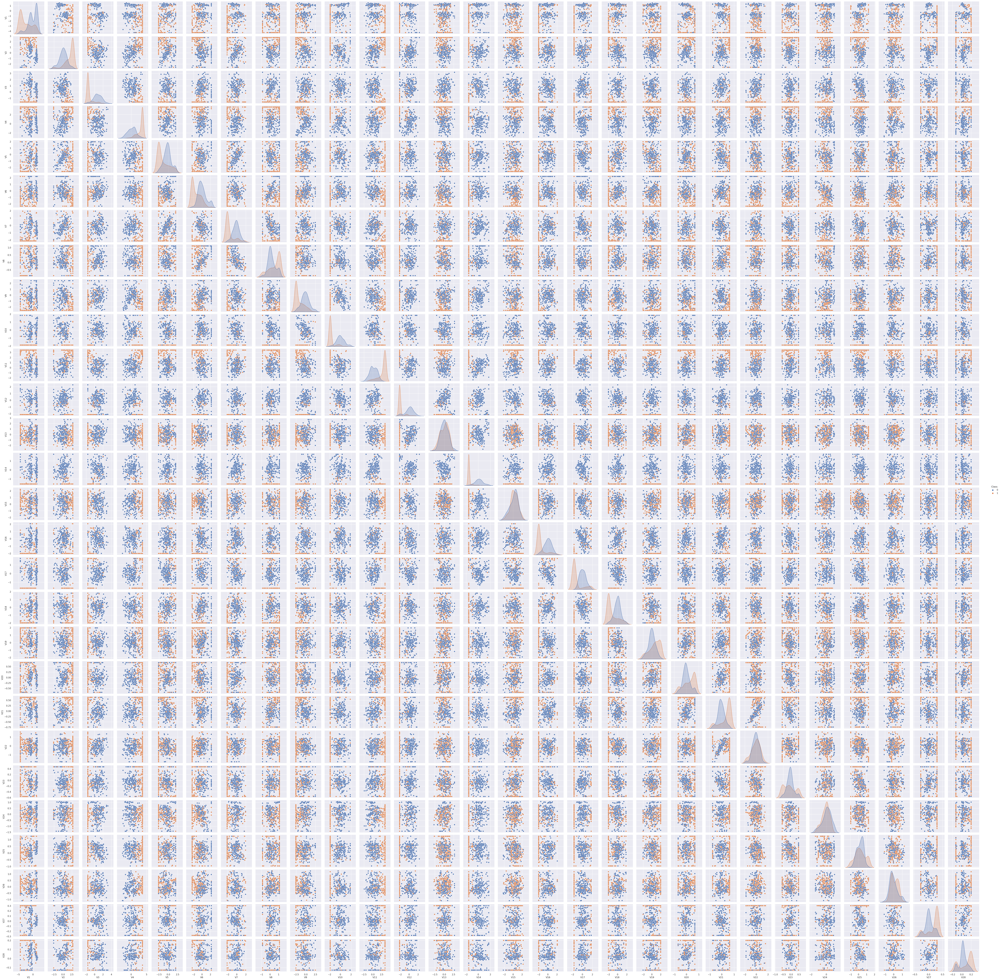

In [10]:
sns.pairplot(balanced_df, hue='Class')  #pairplot
#plt.savefig('plots/pairplot.png')
plt.show()

In [11]:
df.corr()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
V1,1.000000,-0.199245,-0.146979,0.039294,-0.096725,0.006308,-0.152806,-0.134250,-0.009289,0.100657,...,-0.099118,-0.090689,-0.105368,-0.121439,-0.003236,0.306566,0.023440,-0.027264,0.052672,-0.074842
V2,-0.199245,1.000000,0.002930,0.182577,0.227980,-0.079218,0.239149,0.025425,0.003740,-0.061285,...,-0.078736,-0.149309,-0.062504,0.093142,-0.007351,-0.180468,-0.038100,0.129148,-0.027902,0.081828
V3,-0.146979,0.002930,1.000000,0.050061,-0.060549,-0.056153,0.042910,-0.059250,0.107042,-0.023330,...,-0.053713,0.088579,0.285646,0.044980,0.025002,-0.258135,0.035743,0.049749,-0.024652,-0.100505
V4,0.039294,0.182577,0.050061,1.000000,0.029124,0.033176,0.070558,0.018526,0.090623,-0.008219,...,0.015291,0.074408,0.040884,-0.007565,-0.002582,0.004011,-0.028006,0.007459,0.050706,0.104895
V5,-0.096725,0.227980,-0.060549,0.029124,1.000000,0.155260,0.184864,0.078472,-0.006733,-0.070508,...,0.037786,-0.127301,-0.112949,-0.014342,-0.034756,-0.002402,-0.063395,0.032188,-0.042181,-0.056331
V6,0.006308,-0.079218,-0.056153,0.033176,0.155260,1.000000,-0.147834,0.339228,0.075039,0.006835,...,0.049428,0.048884,0.087125,-0.087177,-0.136023,0.033465,0.011497,0.018961,-0.003886,-0.067944
V7,-0.152806,0.239149,0.042910,0.070558,0.184864,-0.147834,1.000000,-0.343581,-0.014336,-0.139765,...,0.147372,-0.055432,-0.072650,-0.020278,-0.008627,-0.167901,-0.055196,-0.112135,-0.024498,-0.085882
V8,-0.134250,0.025425,-0.059250,0.018526,0.078472,0.339228,-0.343581,1.000000,-0.006569,-0.141939,...,-0.010701,0.118165,0.087481,0.070559,-0.012601,-0.064194,0.021473,0.124570,-0.013274,0.043431
V9,-0.009289,0.003740,0.107042,0.090623,-0.006733,0.075039,-0.014336,-0.006569,1.000000,-0.356397,...,0.043499,-0.068310,0.047137,-0.083048,0.011482,0.110552,0.125730,0.000866,-0.046050,-0.076958
V10,0.100657,-0.061285,-0.023330,-0.008219,-0.070508,0.006835,-0.139765,-0.141939,-0.356397,1.000000,...,-0.075269,-0.128798,-0.035881,0.020761,0.001907,-0.012745,-0.037282,-0.000660,-0.050553,-0.098042


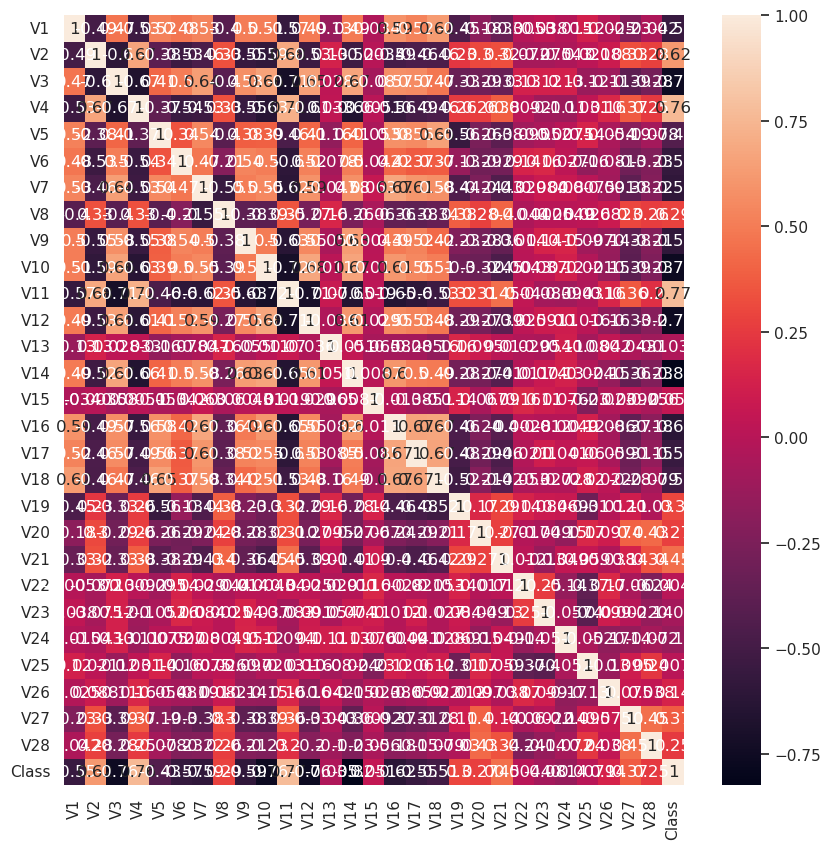

In [12]:
plt.figure(figsize=(10,10))
sns.heatmap(balanced_df.corr(), annot = True)
plt.show()

# Unbalanced dataset and DT

In [13]:
# 1. arrange data into features & target arrays
X = df.iloc[:,:28]
y = df.iloc[:,28] 

print(X)
print(y)

             V1        V2        V3        V4        V5        V6        V7  \
0     -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1      1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2     -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3     -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4     -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   
...         ...       ...       ...       ...       ...       ...       ...   
99994 -0.228866  0.086431  0.791165 -1.451021  1.141154  0.070110  0.442420   
99995 -1.336121  1.671947  0.994155  0.420318 -0.440923 -0.008386 -0.893860   
99996  0.662465 -1.336560  0.791566  0.425701 -1.391976  0.145471 -0.476652   
99997 -4.300244 -1.090715  0.298037  1.890524 -1.058087 -0.329315 -1.498278   
99998  0.982019 -0.161026  0.534280  0.714558  0.108865  1.154723 -0.298831   

             V8        V9       V10  ...       V19 

In [14]:
# 2. Split data into a training set and test set
#    Splitting data into 80% training and 20% test data:

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)
print('Labels count in y:', np.bincount(y))
print('Labels count in y_train:', np.bincount(y_train))
print('Labels count in y_test:', np.bincount(y_test))

print(X_train.shape)
print(X_test.shape)
print(X_train)

Labels count in y: [99776   223]
Labels count in y_train: [79822   177]
Labels count in y_test: [19954    46]
(79999, 28)
(20000, 28)
             V1        V2        V3        V4        V5        V6        V7  \
64470 -0.212567  1.081452  0.630579  1.010333  0.588273 -0.388884  0.540344   
45557  1.078540 -0.562184  1.199141  1.297798 -0.865169  1.374870 -1.262026   
27614 -1.977667 -0.977789  0.191764  2.112787 -2.078404  0.667785  1.936982   
13568 -0.254508  1.082387 -0.593772 -0.109728  1.972299  2.187695  0.430333   
92726 -0.651790  0.094893  1.692517 -0.814058 -2.052049 -0.096454  1.138893   
...         ...       ...       ...       ...       ...       ...       ...   
6265  -3.380582  2.737407 -1.622546 -1.289386  1.221429  2.187695 -1.010814   
54886 -0.742665 -0.033844  2.534524 -1.873237 -0.838732  0.047068 -0.295144   
76820 -0.427834  0.888732  1.189344 -0.149476 -0.446611 -0.719955  0.355365   
860   -0.833568  0.606174 -0.051329 -2.091447  0.968764 -0.030220  0.887288 

In [15]:
datatree = DecisionTreeClassifier()
datatree.fit(X_train,y_train)

DecisionTreeClassifier()

In [16]:
# report
y_test_pred = datatree.predict(X_test)
y_train_pred = datatree.predict(X_train)

print('Classification Report: DT \n', classification_report(y_test,y_test_pred))
print('Training accuracy score of DT is: ', accuracy_score(y_train, y_train_pred))
print('Roc_Auc training score of DT is: ', roc_auc_score(y_train, y_train_pred))
print('Test accuracy score of DT is: ', accuracy_score(y_test, y_test_pred))
print('Roc_Auc test score of DT is: ', roc_auc_score(y_test, y_test_pred))
print('\n')
print(confusion_matrix(y_test,y_test_pred))
print('\n')

print('Accuracy: ', accuracy_score(y_test, y_test_pred))
print('Precision: ', precision_score(y_test, y_test_pred))
print('Recall: ', recall_score(y_test, y_test_pred))
print('F1: ', f1_score(y_test, y_test_pred))
print('\n')
print('k-fold crossvalidation Average: ', np.mean(cross_val_score(datatree, X, y, cv=5)))

Classification Report: DT 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     19954
           1       0.76      0.67      0.71        46

    accuracy                           1.00     20000
   macro avg       0.88      0.84      0.86     20000
weighted avg       1.00      1.00      1.00     20000

Training accuracy score of DT is:  1.0
Roc_Auc training score of DT is:  1.0
Test accuracy score of DT is:  0.99875
Roc_Auc test score of DT is:  0.8367059454135816


[[19944    10]
 [   15    31]]


Accuracy:  0.99875
Precision:  0.7560975609756098
Recall:  0.6739130434782609
F1:  0.7126436781609194


k-fold crossvalidation Average:  0.9812599924996249


In [17]:
# plt.figure(figsize=(9, 8))
# sns.heatmap(cm,square=True,linewidth = 0.5,annot = True)
# plt.xlabel('Actual Value')
# plt.ylabel('Predicted value')
# title = 'Accuracy score: {0}'.format(datatree.score(X_test,y_test))
# plt.title(title,size=15)

In [18]:
# plt.figure(figsize=(10, 10))
# dec_tree = plot_tree(decision_tree = datatree, feature_names = df.columns, 
#                    class_names = ['0','1'],
#                    rounded = True,filled = True,precision = True)

# Unbalanced dataset and kNN

In [19]:
# 1. Arrange the data into featues and target arrays.
# extract features
X = df.iloc[:,:28]
y = df.iloc[:,28] 

print(X)
print(y)

             V1        V2        V3        V4        V5        V6        V7  \
0     -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1      1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2     -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3     -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4     -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   
...         ...       ...       ...       ...       ...       ...       ...   
99994 -0.228866  0.086431  0.791165 -1.451021  1.141154  0.070110  0.442420   
99995 -1.336121  1.671947  0.994155  0.420318 -0.440923 -0.008386 -0.893860   
99996  0.662465 -1.336560  0.791566  0.425701 -1.391976  0.145471 -0.476652   
99997 -4.300244 -1.090715  0.298037  1.890524 -1.058087 -0.329315 -1.498278   
99998  0.982019 -0.161026  0.534280  0.714558  0.108865  1.154723 -0.298831   

             V8        V9       V10  ...       V19 

In [20]:
# 2. Split data into a training set and test set
#    Splitting data into 80% training and 20% test data:

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=1, stratify=y)

print('Labels count in y:', np.bincount(y))
print('Labels count in y_train:', np.bincount(y_train))
print('Labels count in y_test:', np.bincount(y_test))

print(X_train.shape)
print(X_test.shape)
print(X_train)

Labels count in y: [99776   223]
Labels count in y_train: [79821   178]
Labels count in y_test: [19955    45]
(79999, 28)
(20000, 28)
             V1        V2        V3        V4        V5        V6        V7  \
90267  1.497944 -0.246422 -0.483434 -0.834949 -0.202680 -0.963933  0.017334   
71412  1.238842 -0.280915  0.508336  0.493490 -0.845343 -0.575935 -0.330461   
44789  1.257921  0.384704  0.312653  0.687960 -0.333197 -1.060925  0.112969   
5247  -0.603835  0.877077  2.271564  1.795448 -0.511211  0.292644  0.035268   
66198 -0.312369  0.944738  1.430605  0.627951  0.317725 -0.180406  0.793108   
...         ...       ...       ...       ...       ...       ...       ...   
7015   1.154583 -0.133731  0.898467  0.870063 -0.391398  0.687481 -0.674297   
25047  1.013545  0.307677 -0.160985  1.387691 -0.031184 -0.445978  0.037922   
81586 -2.363612  1.406509 -0.086028  0.208324 -1.020019 -1.145995 -0.626612   
70825  1.234592  0.421193  0.312203  1.113468 -0.186708 -0.942279  0.293752 

In [21]:
# Standardize the features
# we only wanna standardize the training set not the raw data.
# This is why we do this now
# z = (x - u) / s
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
sc.fit(X_train)
X_train_std = sc.transform(X_train)
X_test_std = sc.transform(X_test)

print(X_train_std.shape)
print(X_test_std.shape)

(79999, 28)
(20000, 28)


In [22]:
# 3. Select the ML algorithm, and its parameteters

knn = KNeighborsClassifier(n_neighbors=24, # chose 24 becasue its the sqrt of number of data
                                           # points in my training set (569)
                           p=2, 
                           metric='minkowski')

In [23]:
# 4. Build the model (.fit)

knn.fit(X_train_std, y_train)

KNeighborsClassifier(n_neighbors=24)

In [24]:
# 5. Apply the model to the test data (.predict)

y_pred = knn.predict(X_test_std)

In [25]:
# 6. Estimate performance (accuracy score)

print(metrics.accuracy_score(y_test, y_pred))

0.9989


In [26]:
# report
y_test_pred = datatree.predict(X_test)
y_train_pred = datatree.predict(X_train)

print('Classification Report: DT \n', classification_report(y_test,y_test_pred))
print('Training accuracy score of DT is: ', accuracy_score(y_train, y_train_pred))
print('Roc_Auc training score of DT is: ', roc_auc_score(y_train, y_train_pred))
print('Test accuracy score of DT is: ', accuracy_score(y_test, y_test_pred))
print('Roc_Auc test score of DT is: ', roc_auc_score(y_test, y_test_pred))
print('\n')
print(confusion_matrix(y_test,y_pred))
print('\n')

print('Accuracy: ', accuracy_score(y_test, y_pred))
print('Precision: ', precision_score(y_test, y_pred))
print('Recall: ', recall_score(y_test, y_pred))
print('F1: ', f1_score(y_test, y_pred))
print('\n')
print('k-fold crossvalidation Average: ', np.mean(cross_val_score(knn, X, y, cv=5)))

Classification Report: DT 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     19955
           1       0.98      0.98      0.98        45

    accuracy                           1.00     20000
   macro avg       0.99      0.99      0.99     20000
weighted avg       1.00      1.00      1.00     20000

Training accuracy score of DT is:  0.9997124964062051
Roc_Auc training score of DT is:  0.9606177811617539
Test accuracy score of DT is:  0.9999
Roc_Auc test score of DT is:  0.988863832512041


[[19951     4]
 [   18    27]]


Accuracy:  0.9989
Precision:  0.8709677419354839
Recall:  0.6
F1:  0.7105263157894737


k-fold crossvalidation Average:  0.998519992499625


# Unbalanced dataset and SVM

In [27]:
# 1. Arrange the data into featues and target arrays.
# extract features
X_train = df.iloc[:,:28]
Y_train = df.iloc[:,28] 

print(X_train)
print(Y_train)

             V1        V2        V3        V4        V5        V6        V7  \
0     -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1      1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2     -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3     -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4     -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   
...         ...       ...       ...       ...       ...       ...       ...   
99994 -0.228866  0.086431  0.791165 -1.451021  1.141154  0.070110  0.442420   
99995 -1.336121  1.671947  0.994155  0.420318 -0.440923 -0.008386 -0.893860   
99996  0.662465 -1.336560  0.791566  0.425701 -1.391976  0.145471 -0.476652   
99997 -4.300244 -1.090715  0.298037  1.890524 -1.058087 -0.329315 -1.498278   
99998  0.982019 -0.161026  0.534280  0.714558  0.108865  1.154723 -0.298831   

             V8        V9       V10  ...       V19 

In [28]:
# 2. Split data into a training set and test set
#    Splitting data into 80% training and 20% test data

X_train, X_test, y_train, y_test = train_test_split(
    X_train, Y_train, test_size=0.2, random_state=1, stratify=Y_train)

In [29]:
# Standardize the features to account for different types of data
# Doing this helps the ML algorithm 

sc = StandardScaler()
sc.fit(X_train)
X_train_std = sc.transform(X_train)
X_test_std = sc.transform(X_test)

In [30]:
# 3. Select the ML algorithm, and its parameteters
svm = SVC(kernel='linear')

In [31]:
# 4. Build the model (.fit)
svm.fit(X_train_std, y_train)

SVC(kernel='linear')

In [32]:
# 5. Apply the model to the test data (.predict)
y_pred = svm.predict(X_test_std)

In [33]:
# 6. Estimate performance (accuracy score)
svm_proformance = metrics.accuracy_score(y_test, y_pred)
print(svm_proformance)

0.9991


In [34]:
# report
y_test_pred = datatree.predict(X_test_std)
y_train_pred = datatree.predict(X_train_std)

print('Classification Report: DT \n', classification_report(y_test,y_test_pred))
print('Training accuracy score of DT is: ', accuracy_score(y_train, y_train_pred))
print('Roc_Auc training score of DT is: ', roc_auc_score(y_train, y_train_pred))
print('Test accuracy score of DT is: ', accuracy_score(y_test, y_test_pred))
print('Roc_Auc test score of DT is: ', roc_auc_score(y_test, y_test_pred))
print('\n')
print(confusion_matrix(y_test,y_pred))
print('\n')

print('Accuracy: ', accuracy_score(y_test, y_pred))
print('Precision: ', precision_score(y_test, y_pred))
print('Recall: ', recall_score(y_test, y_pred))
print('F1: ', f1_score(y_test, y_pred))
print('\n')
print('k-fold crossvalidation Average: ', np.mean(cross_val_score(svm, X_train, y_train, cv=5)))

Classification Report: DT 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     19955
           1       0.84      0.60      0.70        45

    accuracy                           1.00     20000
   macro avg       0.92      0.80      0.85     20000
weighted avg       1.00      1.00      1.00     20000

Training accuracy score of DT is:  0.9987624845310566
Roc_Auc training score of DT is:  0.8003864053122233
Test accuracy score of DT is:  0.99885
Roc_Auc test score of DT is:  0.7998747181157605


[[19945    10]
 [    8    37]]


Accuracy:  0.9991
Precision:  0.7872340425531915
Recall:  0.8222222222222222
F1:  0.8043478260869565




/opt/conda/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


k-fold crossvalidation Average:  0.9991999921870116


In [35]:
# now rbf
# 3. Select the ML algorithm, and its parameteters
svm = SVC(kernel='rbf')

In [36]:
# 4. Build the model (.fit)
svm.fit(X_train_std, y_train)

SVC()

In [37]:
# 5. Apply the model to the test data (.predict)
y_pred = svm.predict(X_test_std)

In [38]:
# 6. Estimate performance (accuracy score)
svm_proformance = metrics.accuracy_score(y_test, y_pred)
print(svm_proformance)

0.9993


In [39]:
# report
y_test_pred = datatree.predict(X_test_std)
y_train_pred = datatree.predict(X_train_std)

print('Classification Report: DT \n', classification_report(y_test,y_test_pred))
print('Training accuracy score of DT is: ', accuracy_score(y_train, y_train_pred))
print('Roc_Auc training score of DT is: ', roc_auc_score(y_train, y_train_pred))
print('Test accuracy score of DT is: ', accuracy_score(y_test, y_test_pred))
print('Roc_Auc test score of DT is: ', roc_auc_score(y_test, y_test_pred))
print('\n')
print(confusion_matrix(y_test,y_pred))
print('\n')

print('Accuracy: ', accuracy_score(y_test, y_pred))
print('Precision: ', precision_score(y_test, y_pred))
print('Recall: ', recall_score(y_test, y_pred))
print('F1: ', f1_score(y_test, y_pred))
print('\n')
print('k-fold crossvalidation Average: ', np.mean(cross_val_score(svm, X_train, y_train, cv=5)))

Classification Report: DT 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     19955
           1       0.84      0.60      0.70        45

    accuracy                           1.00     20000
   macro avg       0.92      0.80      0.85     20000
weighted avg       1.00      1.00      1.00     20000

Training accuracy score of DT is:  0.9987624845310566
Roc_Auc training score of DT is:  0.8003864053122233
Test accuracy score of DT is:  0.99885
Roc_Auc test score of DT is:  0.7998747181157605


[[19951     4]
 [   10    35]]


Accuracy:  0.9993
Precision:  0.8974358974358975
Recall:  0.7777777777777778
F1:  0.8333333333333333




/opt/conda/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


k-fold crossvalidation Average:  0.9992499937496093


# Balanced dataset and DT

In [40]:
# 1. arrange data into features & target arrays
X = balanced_df.iloc[:,:28]
y = balanced_df.iloc[:,28] 

print(X)
print(y)

           V1        V2        V3        V4        V5        V6        V7  \
0   -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
1   -3.240187  2.737407 -1.622546  3.648203 -2.621212 -0.126271 -2.122524   
2   -0.696353  0.359000 -0.334748 -1.073729  1.972299  2.187695  0.633839   
3    0.326007  1.286638 -1.622546  2.419675 -1.532902 -1.432803 -2.122524   
4   -0.565523  1.366021  0.966902  0.923868 -0.058761 -0.825999  0.488382   
..        ...       ...       ...       ...       ...       ...       ...   
441  1.232541 -0.229078 -0.332437  0.085030  1.574014  2.187695 -1.130610   
442 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.120937 -2.122524   
443 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
444 -4.300244  2.737407 -1.622546  3.258845 -2.621212 -0.637328 -2.122524   
445 -0.761016 -2.600381 -0.849505 -0.367714 -2.611881  0.718978  0.109004   

           V8        V9       V10  ...       V19       V20       V21  \
0  

In [41]:
# 2. Split data into a training set and test set
#    Splitting data into 80% training and 20% test data:

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42)
print('Labels count in y:', np.bincount(y))
print('Labels count in y_train:', np.bincount(y_train))
print('Labels count in y_test:', np.bincount(y_test))

print(X_train.shape)
print(X_test.shape)
print(X_train)

Labels count in y: [223 223]
Labels count in y_train: [176 180]
Labels count in y_test: [47 43]
(356, 28)
(90, 28)
           V1        V2        V3        V4        V5        V6        V7  \
17  -2.661802  2.737407 -1.622546  3.648203 -0.060712 -2.349210 -2.122524   
66  -4.300244 -2.600381 -1.622546  3.416754  1.972299 -2.349210 -2.122524   
176 -4.300244 -0.253767 -0.245699  0.920633  0.205554 -1.606708 -0.595948   
247 -3.912060 -2.600381  0.271321  2.602727  0.271351  0.063458 -0.376922   
31  -1.348042  2.522821 -0.782432  3.648203 -0.662280 -0.598776 -1.943552   
..        ...       ...       ...       ...       ...       ...       ...   
106  0.942241 -1.455678  1.026171 -0.581026 -1.820857  0.084203 -1.143405   
270 -0.474508  0.883889  1.638390 -0.083284 -0.252319 -0.728008  0.501378   
348 -0.549894  1.067196  1.299040 -0.056298  0.258702 -0.532194  0.765274   
435 -1.282613  0.912519  2.324093  1.165745 -0.834031 -0.021527 -0.344472   
102 -0.279809  0.877229  1.297530  0.6

In [42]:
datatree = DecisionTreeClassifier()
datatree.fit(X_train,y_train)

DecisionTreeClassifier()

In [43]:
# report
y_test_pred = datatree.predict(X_test)
y_train_pred = datatree.predict(X_train)

print('Classification Report: DT \n', classification_report(y_test,y_test_pred))
print('Training accuracy score of DT is: ', accuracy_score(y_train, y_train_pred))
print('Roc_Auc training score of DT is: ', roc_auc_score(y_train, y_train_pred))
print('Test accuracy score of DT is: ', accuracy_score(y_test, y_test_pred))
print('Roc_Auc test score of DT is: ', roc_auc_score(y_test, y_test_pred))
print('\n')
print(confusion_matrix(y_test,y_test_pred))
print('\n')

print('Accuracy: ', accuracy_score(y_test, y_test_pred))
print('Precision: ', precision_score(y_test, y_test_pred))
print('Recall: ', recall_score(y_test, y_test_pred))
print('F1: ', f1_score(y_test, y_test_pred))
print('\n')
print('k-fold crossvalidation Average: ', np.mean(cross_val_score(datatree, X, y, cv=5)))

Classification Report: DT 
               precision    recall  f1-score   support

           0       0.96      0.94      0.95        47
           1       0.93      0.95      0.94        43

    accuracy                           0.94        90
   macro avg       0.94      0.94      0.94        90
weighted avg       0.94      0.94      0.94        90

Training accuracy score of DT is:  1.0
Roc_Auc training score of DT is:  1.0
Test accuracy score of DT is:  0.9444444444444444
Roc_Auc test score of DT is:  0.9448292924294903


[[44  3]
 [ 2 41]]


Accuracy:  0.9444444444444444
Precision:  0.9318181818181818
Recall:  0.9534883720930233
F1:  0.942528735632184


k-fold crossvalidation Average:  0.9192759051186018


In [44]:
# plt.figure(figsize=(9, 8))
# sns.heatmap(cm,square=True,linewidth = 0.5,annot = True)
# plt.xlabel('Actual Value')
# plt.ylabel('Predicted value')
# title = 'Accuracy score: {0}'.format(datatree.score(X_test,y_test))
# plt.title(title,size=15)

In [45]:
# plt.figure(figsize=(10, 10))
# dec_tree = plot_tree(decision_tree = datatree, feature_names = df.columns, 
#                    class_names = ['0','1'],
#                    rounded = True,filled = True,precision = True)

# Balanced dataset and kNN

In [46]:
# 1. Arrange the data into featues and target arrays.
# extract features
X = balanced_df.iloc[:,:28]
y = balanced_df.iloc[:,28] 

print(X)
print(y)

           V1        V2        V3        V4        V5        V6        V7  \
0   -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
1   -3.240187  2.737407 -1.622546  3.648203 -2.621212 -0.126271 -2.122524   
2   -0.696353  0.359000 -0.334748 -1.073729  1.972299  2.187695  0.633839   
3    0.326007  1.286638 -1.622546  2.419675 -1.532902 -1.432803 -2.122524   
4   -0.565523  1.366021  0.966902  0.923868 -0.058761 -0.825999  0.488382   
..        ...       ...       ...       ...       ...       ...       ...   
441  1.232541 -0.229078 -0.332437  0.085030  1.574014  2.187695 -1.130610   
442 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.120937 -2.122524   
443 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
444 -4.300244  2.737407 -1.622546  3.258845 -2.621212 -0.637328 -2.122524   
445 -0.761016 -2.600381 -0.849505 -0.367714 -2.611881  0.718978  0.109004   

           V8        V9       V10  ...       V19       V20       V21  \
0  

In [47]:
# 2. Split data into a training set and test set
#    Splitting data into 80% training and 20% test data:

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=1, stratify=y)

print('Labels count in y:', np.bincount(y))
print('Labels count in y_train:', np.bincount(y_train))
print('Labels count in y_test:', np.bincount(y_test))

print(X_train.shape)
print(X_test.shape)
print(X_train)

Labels count in y: [223 223]
Labels count in y_train: [178 178]
Labels count in y_test: [45 45]
(356, 28)
(90, 28)
           V1        V2        V3        V4        V5        V6        V7  \
440  1.334490 -0.577413  0.445595 -0.695736 -0.988642 -0.643041 -0.606046   
207 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
6    1.011520  0.110030  0.468605  1.295511  0.358212  1.199259 -0.161329   
86  -3.843009  2.737407 -1.622546  3.648203  1.972299 -2.349210 -1.668931   
404 -4.300244  2.737407 -1.622546  3.616119 -2.493138 -1.090000 -2.122524   
..        ...       ...       ...       ...       ...       ...       ...   
304 -2.740483  2.737407 -1.622546  3.648203 -2.621212 -0.092782 -2.122524   
237  1.081234  0.416414  0.862919  2.520863 -0.005021  0.563341 -0.123372   
277 -1.309441  1.786495 -1.371070  1.214335 -0.336642 -1.390120 -1.709109   
159  1.176716  0.557091 -0.490800  0.756424  0.249192 -0.781871  0.228750   
383 -0.655672 -0.087975  1.067574 -2.6

In [48]:
# Standardize the features
# we only wanna standardize the training set not the raw data.
# This is why we do this now
# z = (x - u) / s
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
sc.fit(X_train)
X_train_std = sc.transform(X_train)
X_test_std = sc.transform(X_test)

print(X_train_std.shape)
print(X_test_std.shape)

(356, 28)
(90, 28)


In [49]:
# 3. Select the ML algorithm, and its parameteters

knn = KNeighborsClassifier(n_neighbors=24, # chose 24 becasue its the sqrt of number of data
                                           # points in my training set (569)
                           p=2, 
                           metric='minkowski')

In [50]:
# 4. Build the model (.fit)

knn.fit(X_train_std, y_train)

KNeighborsClassifier(n_neighbors=24)

In [51]:
# 5. Apply the model to the test data (.predict)

y_pred = knn.predict(X_test_std)

In [52]:
# 6. Estimate performance (accuracy score)

print(metrics.accuracy_score(y_test, y_pred))

0.9222222222222223


In [53]:
# report
y_test_pred = datatree.predict(X_test)
y_train_pred = datatree.predict(X_train)

print('Classification Report: DT \n', classification_report(y_test,y_test_pred))
print('Training accuracy score of DT is: ', accuracy_score(y_train, y_train_pred))
print('Roc_Auc training score of DT is: ', roc_auc_score(y_train, y_train_pred))
print('Test accuracy score of DT is: ', accuracy_score(y_test, y_test_pred))
print('Roc_Auc test score of DT is: ', roc_auc_score(y_test, y_test_pred))
print('\n')
print(confusion_matrix(y_test,y_pred))
print('\n')

print('Accuracy: ', accuracy_score(y_test, y_pred))
print('Precision: ', precision_score(y_test, y_pred))
print('Recall: ', recall_score(y_test, y_pred))
print('F1: ', f1_score(y_test, y_pred))
print('\n')
print('k-fold crossvalidation Average: ', np.mean(cross_val_score(knn, X, y, cv=5)))

Classification Report: DT 
               precision    recall  f1-score   support

           0       1.00      0.98      0.99        45
           1       0.98      1.00      0.99        45

    accuracy                           0.99        90
   macro avg       0.99      0.99      0.99        90
weighted avg       0.99      0.99      0.99        90

Training accuracy score of DT is:  0.9887640449438202
Roc_Auc training score of DT is:  0.9887640449438202
Test accuracy score of DT is:  0.9888888888888889
Roc_Auc test score of DT is:  0.9888888888888888


[[45  0]
 [ 7 38]]


Accuracy:  0.9222222222222223
Precision:  1.0
Recall:  0.8444444444444444
F1:  0.9156626506024096


k-fold crossvalidation Average:  0.9394257178526841


# Balanced dataset and SVM

In [54]:
# 1. Arrange the data into featues and target arrays.
# extract features
X_train = balanced_df.iloc[:,:28]
Y_train = balanced_df.iloc[:,28] 

print(X_train)
print(Y_train)

           V1        V2        V3        V4        V5        V6        V7  \
0   -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
1   -3.240187  2.737407 -1.622546  3.648203 -2.621212 -0.126271 -2.122524   
2   -0.696353  0.359000 -0.334748 -1.073729  1.972299  2.187695  0.633839   
3    0.326007  1.286638 -1.622546  2.419675 -1.532902 -1.432803 -2.122524   
4   -0.565523  1.366021  0.966902  0.923868 -0.058761 -0.825999  0.488382   
..        ...       ...       ...       ...       ...       ...       ...   
441  1.232541 -0.229078 -0.332437  0.085030  1.574014  2.187695 -1.130610   
442 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.120937 -2.122524   
443 -4.300244  2.737407 -1.622546  3.648203 -2.621212 -2.349210 -2.122524   
444 -4.300244  2.737407 -1.622546  3.258845 -2.621212 -0.637328 -2.122524   
445 -0.761016 -2.600381 -0.849505 -0.367714 -2.611881  0.718978  0.109004   

           V8        V9       V10  ...       V19       V20       V21  \
0  

In [55]:
# 2. Split data into a training set and test set
#    Splitting data into 80% training and 20% test data

X_train, X_test, y_train, y_test = train_test_split(
    X_train, Y_train, test_size=0.2, random_state=1, stratify=Y_train)

In [56]:
# Standardize the features to account for different types of data
# Doing this helps the ML algorithm 

sc = StandardScaler()
sc.fit(X_train)
X_train_std = sc.transform(X_train)
X_test_std = sc.transform(X_test)

In [57]:
# 3. Select the ML algorithm, and its parameteters
svm = SVC(kernel='linear')

In [58]:
# 4. Build the model (.fit)
svm.fit(X_train_std, y_train)

SVC(kernel='linear')

In [59]:
# 5. Apply the model to the test data (.predict)
y_pred = svm.predict(X_test_std)

In [60]:
# 6. Estimate performance (accuracy score)
svm_proformance = metrics.accuracy_score(y_test, y_pred)
print(svm_proformance)

0.9222222222222223


In [61]:
# report
y_test_pred = datatree.predict(X_test_std)
y_train_pred = datatree.predict(X_train_std)

print('Classification Report: DT \n', classification_report(y_test,y_test_pred))
print('Training accuracy score of DT is: ', accuracy_score(y_train, y_train_pred))
print('Roc_Auc training score of DT is: ', roc_auc_score(y_train, y_train_pred))
print('Test accuracy score of DT is: ', accuracy_score(y_test, y_test_pred))
print('Roc_Auc test score of DT is: ', roc_auc_score(y_test, y_test_pred))
print('\n')
print(confusion_matrix(y_test,y_pred))
print('\n')

print('Accuracy: ', accuracy_score(y_test, y_pred))
print('Precision: ', precision_score(y_test, y_pred))
print('Recall: ', recall_score(y_test, y_pred))
print('F1: ', f1_score(y_test, y_pred))
print('\n')
print('k-fold crossvalidation Average: ', np.mean(cross_val_score(svm, X_train, y_train, cv=5)))

Classification Report: DT 
               precision    recall  f1-score   support

           0       0.62      0.89      0.73        45
           1       0.80      0.44      0.57        45

    accuracy                           0.67        90
   macro avg       0.71      0.67      0.65        90
weighted avg       0.71      0.67      0.65        90

Training accuracy score of DT is:  0.6629213483146067
Roc_Auc training score of DT is:  0.6629213483146067
Test accuracy score of DT is:  0.6666666666666666
Roc_Auc test score of DT is:  0.6666666666666666


[[40  5]
 [ 2 43]]


Accuracy:  0.9222222222222223
Precision:  0.8958333333333334
Recall:  0.9555555555555556
F1:  0.924731182795699


k-fold crossvalidation Average:  0.9437402190923319


/opt/conda/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


In [62]:
# now rbf
# 3. Select the ML algorithm, and its parameteters
svm = SVC(kernel='rbf')

In [63]:
# 4. Build the model (.fit)
svm.fit(X_train_std, y_train)

SVC()

In [64]:
# 5. Apply the model to the test data (.predict)
y_pred = svm.predict(X_test_std)

In [65]:
# 6. Estimate performance (accuracy score)
svm_proformance = metrics.accuracy_score(y_test, y_pred)
print(svm_proformance)

0.9444444444444444


In [66]:
# report
y_test_pred = datatree.predict(X_test_std)
y_train_pred = datatree.predict(X_train_std)

print('Classification Report: DT \n', classification_report(y_test,y_test_pred))
print('Training accuracy score of DT is: ', accuracy_score(y_train, y_train_pred))
print('Roc_Auc training score of DT is: ', roc_auc_score(y_train, y_train_pred))
print('Test accuracy score of DT is: ', accuracy_score(y_test, y_test_pred))
print('Roc_Auc test score of DT is: ', roc_auc_score(y_test, y_test_pred))
print('\n')
print(confusion_matrix(y_test,y_pred))
print('\n')

print('Accuracy: ', accuracy_score(y_test, y_pred))
print('Precision: ', precision_score(y_test, y_pred))
print('Recall: ', recall_score(y_test, y_pred))
print('F1: ', f1_score(y_test, y_pred))
print('\n')
print('k-fold crossvalidation Average: ', np.mean(cross_val_score(svm, X_train, y_train, cv=5)))

Classification Report: DT 
               precision    recall  f1-score   support

           0       0.62      0.89      0.73        45
           1       0.80      0.44      0.57        45

    accuracy                           0.67        90
   macro avg       0.71      0.67      0.65        90
weighted avg       0.71      0.67      0.65        90

Training accuracy score of DT is:  0.6629213483146067
Roc_Auc training score of DT is:  0.6629213483146067
Test accuracy score of DT is:  0.6666666666666666
Roc_Auc test score of DT is:  0.6666666666666666


[[45  0]
 [ 5 40]]


Accuracy:  0.9444444444444444
Precision:  1.0
Recall:  0.8888888888888888
F1:  0.9411764705882353


k-fold crossvalidation Average:  0.9493740219092333


/opt/conda/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/sklearn/base.py:409: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


# Create Learning Curves for DT, kNN and SVM

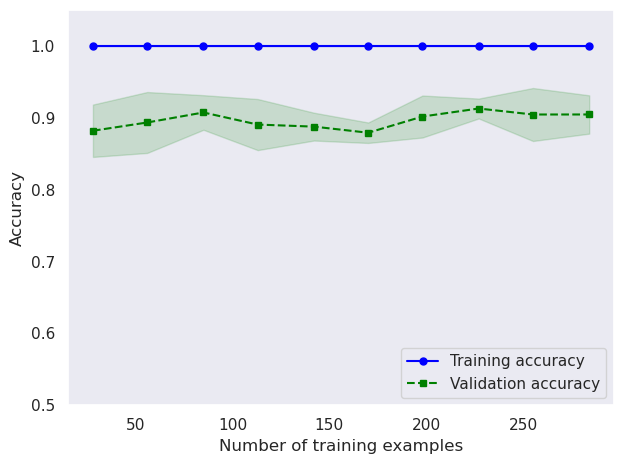

In [67]:
# DT

import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve
from sklearn.pipeline import make_pipeline


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


pipe_dt = make_pipeline(StandardScaler(),
                        DecisionTreeClassifier())

train_sizes, train_scores, test_scores =\
                learning_curve(estimator=pipe_dt,
                               X=X_train,
                               y=y_train,
                               train_sizes=np.linspace(0.1, 1.0, 10),
                               cv=5,
                               n_jobs=1)

#print(train_sizes)
#print(train_scores)
#print(test_scores)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.plot(train_sizes, train_mean,
         color='blue', marker='o',
         markersize=5, label='Training accuracy')

plt.fill_between(train_sizes,
                 train_mean + train_std,
                 train_mean - train_std,
                 alpha=0.15, color='blue')

plt.plot(train_sizes, test_mean,
         color='green', linestyle='--',
         marker='s', markersize=5,
         label='Validation accuracy')

plt.fill_between(train_sizes,
                 test_mean + test_std,
                 test_mean - test_std,
                 alpha=0.15, color='green')

plt.grid()
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.ylim([0.5, 1.05])
plt.tight_layout()
# plt.savefig('images/06_05.png', dpi=300)
plt.show()

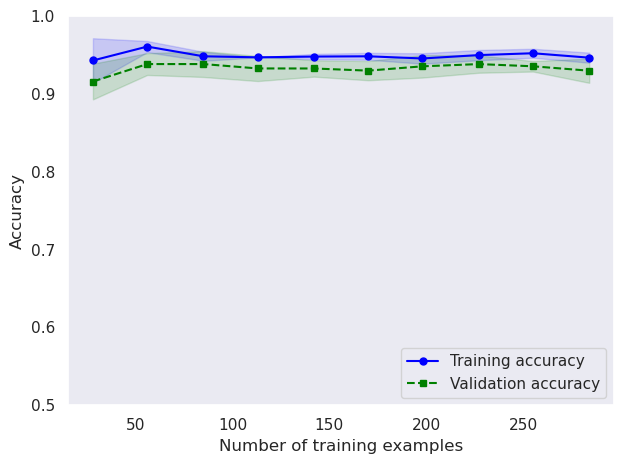

In [68]:
# kNN

import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve
from sklearn.pipeline import make_pipeline


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


pipe_knn = make_pipeline(StandardScaler(),
                        KNeighborsClassifier())

train_sizes, train_scores, test_scores =\
                learning_curve(estimator=pipe_knn,
                               X=X_train,
                               y=y_train,
                               train_sizes=np.linspace(0.1, 1.0, 10),
                               cv=5,
                               n_jobs=1)

#print(train_sizes)
#print(train_scores)
#print(test_scores)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.plot(train_sizes, train_mean,
         color='blue', marker='o',
         markersize=5, label='Training accuracy')

plt.fill_between(train_sizes,
                 train_mean + train_std,
                 train_mean - train_std,
                 alpha=0.15, color='blue')

plt.plot(train_sizes, test_mean,
         color='green', linestyle='--',
         marker='s', markersize=5,
         label='Validation accuracy')

plt.fill_between(train_sizes,
                 test_mean + test_std,
                 test_mean - test_std,
                 alpha=0.15, color='green')

plt.grid()
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.ylim([0.5, 1.0])
plt.tight_layout()
# plt.savefig('images/06_05.png', dpi=300)
plt.show()

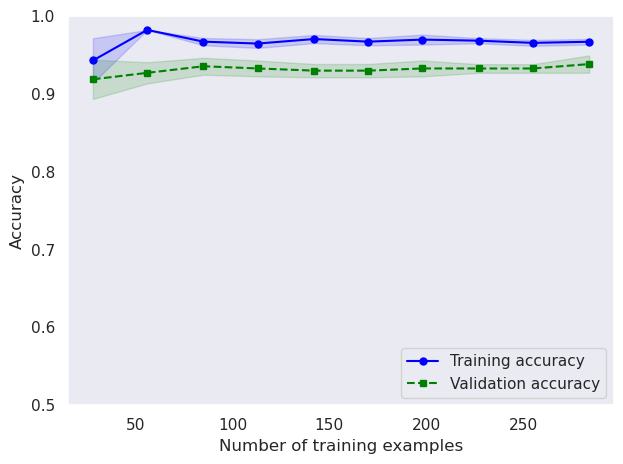

In [69]:
# SVC

import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve
from sklearn.pipeline import make_pipeline


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


pipe_svc = make_pipeline(StandardScaler(),
                        SVC())

train_sizes, train_scores, test_scores =\
                learning_curve(estimator=pipe_svc,
                               X=X_train,
                               y=y_train,
                               train_sizes=np.linspace(0.1, 1.0, 10),
                               cv=5,
                               n_jobs=1)

#print(train_sizes)
#print(train_scores)
#print(test_scores)

train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

plt.plot(train_sizes, train_mean,
         color='blue', marker='o',
         markersize=5, label='Training accuracy')

plt.fill_between(train_sizes,
                 train_mean + train_std,
                 train_mean - train_std,
                 alpha=0.15, color='blue')

plt.plot(train_sizes, test_mean,
         color='green', linestyle='--',
         marker='s', markersize=5,
         label='Validation accuracy')

plt.fill_between(train_sizes,
                 test_mean + test_std,
                 test_mean - test_std,
                 alpha=0.15, color='green')

plt.grid()
plt.xlabel('Number of training examples')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.ylim([0.5, 1.0])
plt.tight_layout()
# plt.savefig('images/06_05.png', dpi=300)
plt.show()

# Perform a Grid Search (with C and gamma = [0.01, 0.1, 1.0, 10.0] and kernel = ['rbf', 'linear']) and produce best score and parameters (optimal parameters for SVC) for Balanced Dataset

In [71]:
# kNN

param_range_knn = [5, 10, 20, 100]
train_scores_knn, test_scores_knn = validation_curve(
                estimator=pipe_knn, 
                X=X_train, 
                y=y_train, 
                param_name='kneighborsclassifier__n_neighbors', 
                param_range=param_range_knn,
                cv=5)

In [72]:
# SVM

param_range_svm = [0.01, 0.1, 1.0, 10.0]
train_scores_svm, test_scores_svm = validation_curve(
                estimator=pipe_svc, 
                X=X_train, 
                y=y_train, 
                param_name='svc__C', 
                param_range=param_range_svm,
                cv=5)

# Create ROC/AUC curve for the optimal SVC

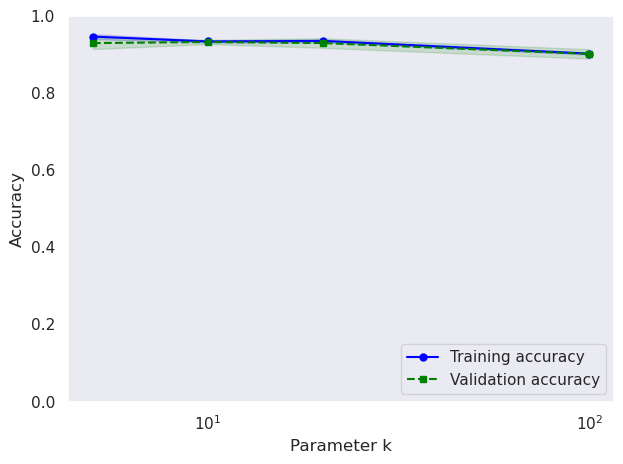

In [73]:
# kNN

train_mean = np.mean(train_scores_knn, axis=1)
train_std = np.std(train_scores_knn, axis=1)
test_mean = np.mean(test_scores_knn, axis=1)
test_std = np.std(test_scores_knn, axis=1)

plt.plot(param_range_knn, train_mean, 
         color='blue', marker='o', 
         markersize=5, label='Training accuracy')

plt.fill_between(param_range_knn, train_mean + train_std,
                 train_mean - train_std, alpha=0.15,
                 color='blue')

plt.plot(param_range_knn, test_mean, 
         color='green', linestyle='--', 
         marker='s', markersize=5, 
         label='Validation accuracy')

plt.fill_between(param_range_knn, 
                 test_mean + test_std,
                 test_mean - test_std, 
                 alpha=0.15, color='green')

plt.grid()
plt.xscale('log')
plt.legend(loc='lower right')
plt.xlabel('Parameter k')
plt.ylabel('Accuracy')
plt.ylim([0.0, 1.0])
plt.tight_layout()
# plt.savefig('images/06_06.png', dpi=300)
plt.show()

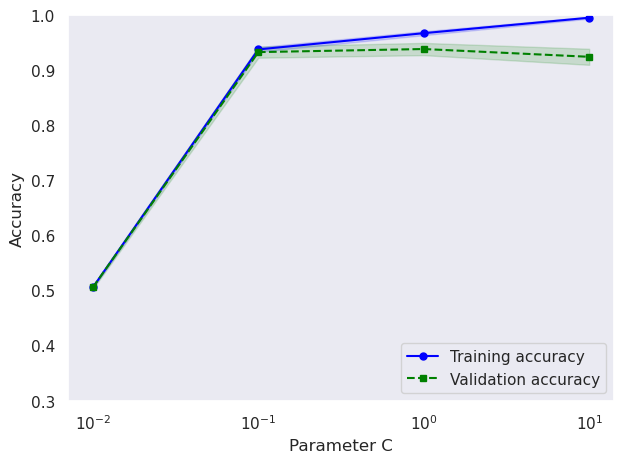

In [74]:
# SVM

train_mean = np.mean(train_scores_svm, axis=1)
train_std = np.std(train_scores_svm, axis=1)
test_mean = np.mean(test_scores_svm, axis=1)
test_std = np.std(test_scores_svm, axis=1)

plt.plot(param_range_svm, train_mean, 
         color='blue', marker='o', 
         markersize=5, label='Training accuracy')

plt.fill_between(param_range_svm, train_mean + train_std,
                 train_mean - train_std, alpha=0.15,
                 color='blue')

plt.plot(param_range_svm, test_mean, 
         color='green', linestyle='--', 
         marker='s', markersize=5, 
         label='Validation accuracy')

plt.fill_between(param_range_svm, 
                 test_mean + test_std,
                 test_mean - test_std, 
                 alpha=0.15, color='green')

plt.grid()
plt.xscale('log')
plt.legend(loc='lower right')
plt.xlabel('Parameter C')
plt.ylabel('Accuracy')
plt.ylim([0.3, 1.0])
plt.tight_layout()
# plt.savefig('images/06_06.png', dpi=300)
plt.show()

# Analysis, Observations and Conclusions

11. The top 4 features coorelate to Genuine transactions are: V2, V4, V8, V11. The top 4 features coorrelate to Fraudulent transactions are: V14, V16. V17. V18.

12. The Classification Reports for the Unbalanced Dataset showed a higher accuracy for each model when compared to the balanced dataset classification reports.

13. The Classification Reports for the Balanced Dataset showed a lower accuracy for each model when compared to the balanced dataset classification reports.

14. After analyzing the Classification Reports for both the Balanced Dataset and Unbalanced Dataset, I determined that the Unbalanced Dataset produced better models in each case.

15. After analyzing the learning curves, I found that for the kNN model is underfit with a high bias, and the SVM model is overfit with a high variance.

16. In order to meet the primary goal, I recommend using the kNN algorithm, trained using the unblanaced dataset.